# 🤪 WGAN - CelebA Faces

In this notebook, we'll walk through the steps required to train your own Wasserstein GAN on the CelebA faces dataset

The code has been adapted from the excellent [WGAN-GP tutorial](https://keras.io/examples/generative/wgan_gp/) created by Aakash Kumar Nain, available on the Keras website.

In [1]:
%load_ext autoreload
%autoreload 2

import os
os.chdir('/home/sherstancraig/work/Generative_Deep_Learning_2nd_Edition')

import numpy as np

import tensorflow as tf
from tensorflow.keras import (
    layers,
    models,
    callbacks,
    utils,
    metrics,
    optimizers,
)

from notebooks.utils import display, sample_batch

2024-01-21 22:03:08.729279: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-01-21 22:03:08.752465: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-01-21 22:03:08.752487: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-01-21 22:03:08.753201: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-01-21 22:03:08.757163: I tensorflow/core/platform/cpu_feature_guar

## 0. Parameters <a name="parameters"></a>

In [2]:
IMAGE_SIZE = 64
CHANNELS = 3
BATCH_SIZE = 512
NUM_FEATURES = 64
Z_DIM = 128
LEARNING_RATE = 0.0002
ADAM_BETA_1 = 0.5
ADAM_BETA_2 = 0.999
EPOCHS = 200
CRITIC_STEPS = 3
GP_WEIGHT = 10.0
LOAD_MODEL = False
ADAM_BETA_1 = 0.5
ADAM_BETA_2 = 0.9

## 1. Prepare the data <a name="prepare"></a>

In [3]:
# Load the data
train_data = utils.image_dataset_from_directory(
    "data/celeba-dataset/img_align_celeba/img_align_celeba",
    labels=None,
    color_mode="rgb",
    image_size=(IMAGE_SIZE, IMAGE_SIZE),
    batch_size=BATCH_SIZE,
    shuffle=True,
    seed=42,
    interpolation="bilinear",
)

Found 202599 files belonging to 1 classes.


2024-01-21 22:03:15.419860: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-01-21 22:03:15.449731: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-01-21 22:03:15.449911: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

In [4]:
# Preprocess the data
def preprocess(img):
    """
    Normalize and reshape the images
    """
    img = (tf.cast(img, "float32") - 127.5) / 127.5
    return img


train = train_data.map(lambda x: preprocess(x))

In [5]:
# Show some faces from the training set
train_sample = sample_batch(train)

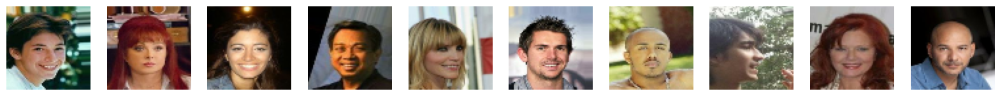

In [6]:
display(train_sample, cmap=None)

## 2. Build the WGAN-GP <a name="build"></a>

In [16]:
critic_input = layers.Input(shape=(IMAGE_SIZE, IMAGE_SIZE, CHANNELS))
x = layers.Conv2D(64, kernel_size=4, strides=2, padding="same")(critic_input)
x = layers.LeakyReLU(0.2)(x)
x = layers.Conv2D(128, kernel_size=4, strides=2, padding="same")(x)
x = layers.LeakyReLU()(x)
x = layers.Dropout(0.3)(x)
x = layers.Conv2D(256, kernel_size=4, strides=2, padding="same")(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Dropout(0.3)(x)
x = layers.Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Dropout(0.3)(x)
x = layers.Conv2D(1, kernel_size=4, strides=1, padding="valid")(x)
critic_output = layers.Flatten()(x)

critic = models.Model(critic_input, critic_output)
critic.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 64, 64, 3)]       0         
                                                                 
 conv2d_5 (Conv2D)           (None, 32, 32, 64)        3136      
                                                                 
 leaky_re_lu_8 (LeakyReLU)   (None, 32, 32, 64)        0         
                                                                 
 conv2d_6 (Conv2D)           (None, 16, 16, 128)       131200    
                                                                 
 leaky_re_lu_9 (LeakyReLU)   (None, 16, 16, 128)       0         
                                                                 
 dropout_3 (Dropout)         (None, 16, 16, 128)       0         
                                                                 
 conv2d_7 (Conv2D)           (None, 8, 8, 256)         5245

In [17]:
generator_input = layers.Input(shape=(Z_DIM,))
x = layers.Reshape((1, 1, Z_DIM))(generator_input)
x = layers.Conv2DTranspose(
    512, kernel_size=4, strides=1, padding="valid", use_bias=False
)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Conv2DTranspose(
    256, kernel_size=4, strides=2, padding="same", use_bias=False
)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Conv2DTranspose(
    128, kernel_size=4, strides=2, padding="same", use_bias=False
)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Conv2DTranspose(
    64, kernel_size=4, strides=2, padding="same", use_bias=False
)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
generator_output = layers.Conv2DTranspose(
    CHANNELS, kernel_size=4, strides=2, padding="same", activation="tanh"
)(x)
generator = models.Model(generator_input, generator_output)
generator.summary()

Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 128)]             0         
                                                                 
 reshape_1 (Reshape)         (None, 1, 1, 128)         0         
                                                                 
 conv2d_transpose_5 (Conv2D  (None, 4, 4, 512)         1048576   
 Transpose)                                                      
                                                                 
 batch_normalization_4 (Bat  (None, 4, 4, 512)         2048      
 chNormalization)                                                
                                                                 
 leaky_re_lu_12 (LeakyReLU)  (None, 4, 4, 512)         0         
                                                                 
 conv2d_transpose_6 (Conv2D  (None, 8, 8, 256)         2097

In [25]:
class WGANGP(models.Model):
    def __init__(self, critic, generator, latent_dim, critic_steps, gp_weight):
        super(WGANGP, self).__init__()
        self.critic = critic
        self.generator = generator
        self.latent_dim = latent_dim
        self.critic_steps = critic_steps
        self.gp_weight = gp_weight

    def compile(self, c_optimizer, g_optimizer):
        super(WGANGP, self).compile()
        self.c_optimizer = c_optimizer
        self.g_optimizer = g_optimizer
        self.c_wass_loss_metric = metrics.Mean(name="c_wass_loss")
        self.c_gp_metric = metrics.Mean(name="c_gp")
        self.c_loss_metric = metrics.Mean(name="c_loss")
        self.c_generated_loss_metric = metrics.Mean(name="c_generated_loss")
        self.c_real_loss_metric = metrics.Mean(name="c_real_loss")
        self.g_loss_metric = metrics.Mean(name="g_loss")

    @property
    def metrics(self):
        return [
            self.c_loss_metric,
            self.c_wass_loss_metric,
            self.c_gp_metric,
            self.g_loss_metric,
            self.c_generated_loss_metric,
            self.c_real_loss_metric,
        ]

    def gradient_penalty(self, batch_size, real_images, fake_images):
        alpha = tf.random.normal([batch_size, 1, 1, 1], 0.0, 1.0)
        diff = fake_images - real_images
        interpolated = real_images + alpha * diff

        with tf.GradientTape() as gp_tape:
            gp_tape.watch(interpolated)
            pred = self.critic(interpolated, training=True)

        grads = gp_tape.gradient(pred, [interpolated])[0]
        print(grads.shape)
        norm = tf.sqrt(tf.reduce_sum(tf.square(grads), axis=[1, 2, 3]))
        gp = tf.reduce_mean((norm - 1.0) ** 2)
        return gp

    def train_step(self, real_images):
        batch_size = tf.shape(real_images)[0]

        for i in range(self.critic_steps):
            random_latent_vectors = tf.random.normal(
                shape=(batch_size, self.latent_dim)
            )

            with tf.GradientTape() as tape:
                fake_images = self.generator(
                    random_latent_vectors, training=True
                )
                fake_predictions = self.critic(fake_images, training=True)
                real_predictions = self.critic(real_images, training=True)
                
                c_generated_loss = tf.reduce_mean(fake_predictions)
                c_real_loss = - tf.reduce_mean(real_predictions)
                
                c_gp = self.gradient_penalty(
                    batch_size, real_images, fake_images
                )
                c_loss = c_generated_loss + c_real_loss + c_gp * self.gp_weight

            c_gradient = tape.gradient(c_loss, self.critic.trainable_variables)
            self.c_optimizer.apply_gradients(
                zip(c_gradient, self.critic.trainable_variables)
            )

        random_latent_vectors = tf.random.normal(
            shape=(batch_size, self.latent_dim)
        )
        with tf.GradientTape() as tape:
            fake_images = self.generator(random_latent_vectors, training=True)
            fake_predictions = self.critic(fake_images, training=True)
            g_loss = -tf.reduce_mean(fake_predictions)

        gen_gradient = tape.gradient(g_loss, self.generator.trainable_variables)
        self.g_optimizer.apply_gradients(
            zip(gen_gradient, self.generator.trainable_variables)
        )

        self.c_loss_metric.update_state(c_loss)
        self.c_generated_loss_metric.update_state(c_generated_loss)
        self.c_real_loss_metric.update_state(c_real_loss)
        self.c_wass_loss_metric.update_state(c_generated_loss + c_real_loss)
        self.c_gp_metric.update_state(c_gp)
        self.g_loss_metric.update_state(g_loss)

        return {m.name: m.result() for m in self.metrics}

In [26]:
# Create a GAN
wgangp = WGANGP(
    critic=critic,
    generator=generator,
    latent_dim=Z_DIM,
    critic_steps=CRITIC_STEPS,
    gp_weight=GP_WEIGHT,
)

In [27]:
if LOAD_MODEL:
    wgangp.load_weights("./checkpoint/checkpoint.ckpt")

## 3. Train the GAN <a name="train"></a>

In [28]:
# Compile the GAN
wgangp.compile(
    c_optimizer=optimizers.Adam(
        learning_rate=LEARNING_RATE, beta_1=ADAM_BETA_1, beta_2=ADAM_BETA_2
    ),
    g_optimizer=optimizers.Adam(
        learning_rate=LEARNING_RATE, beta_1=ADAM_BETA_1, beta_2=ADAM_BETA_2
    ),
)

In [29]:
test_data = tf.stack([tf.ones((IMAGE_SIZE, IMAGE_SIZE, CHANNELS))*0.2, tf.ones((IMAGE_SIZE, IMAGE_SIZE, CHANNELS))*-0.2])
wgangp.train_step(test_data)

(2, 64, 64, 3)
(2, 64, 64, 3)
(2, 64, 64, 3)


{'c_loss': <tf.Tensor: shape=(), dtype=float32, numpy=-34.490044>,
 'c_wass_loss': <tf.Tensor: shape=(), dtype=float32, numpy=-39.37152>,
 'c_gp': <tf.Tensor: shape=(), dtype=float32, numpy=0.48814774>,
 'g_loss': <tf.Tensor: shape=(), dtype=float32, numpy=72.34015>,
 'c_generated_loss': <tf.Tensor: shape=(), dtype=float32, numpy=-46.15494>,
 'c_real_loss': <tf.Tensor: shape=(), dtype=float32, numpy=6.7834206>}

In [30]:
# Create a model save checkpoint
model_checkpoint_callback = callbacks.ModelCheckpoint(
    filepath="./checkpoint/checkpoint.ckpt",
    save_weights_only=True,
    save_freq="epoch",
    verbose=0,
)

tensorboard_callback = callbacks.TensorBoard(log_dir="./logs")


class ImageGenerator(callbacks.Callback):
    def __init__(self, num_img, latent_dim):
        self.num_img = num_img
        self.latent_dim = latent_dim

    def on_epoch_end(self, epoch, logs=None):
        random_latent_vectors = tf.random.normal(
            shape=(self.num_img, self.latent_dim)
        )
        generated_images = self.model.generator(random_latent_vectors)
        generated_images = generated_images * 127.5 + 127.5
        generated_images = generated_images.numpy()
        display(
            generated_images,
            save_to="./output/generated_img_%03d.png" % (epoch),
            cmap=None,
        )

Epoch 1/200
(None, 64, 64, 3)
(None, 64, 64, 3)
(None, 64, 64, 3)


2024-01-21 22:13:09.090896: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel_2/dropout_3/dropout_1/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


2/2 [==============================] - ETA: 0s - c_loss: -4.8412 - c_wass_loss: -8.2448 - c_gp: 0.3404 - g_loss: 38.4034 - c_generated_loss: -48.8033 - c_real_loss: 40.5584
Saved to ./output/generated_img_000.png


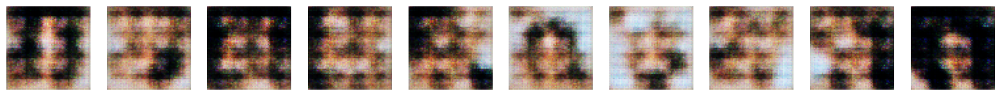

2/2 [==============================] - 4s 1s/step - c_loss: -4.8412 - c_wass_loss: -8.2448 - c_gp: 0.3404 - g_loss: 38.4034 - c_generated_loss: -48.8033 - c_real_loss: 40.5584
Epoch 2/200
2/2 [==============================] - ETA: 0s - c_loss: -9.7193 - c_wass_loss: -11.1807 - c_gp: 0.1461 - g_loss: -25.6426 - c_generated_loss: 20.0341 - c_real_loss: -31.2148
Saved to ./output/generated_img_001.png


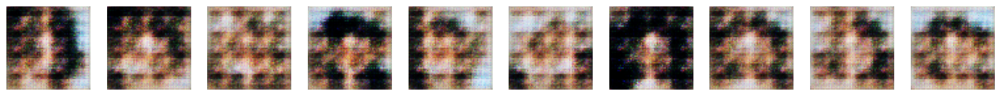

2/2 [==============================] - 2s 1s/step - c_loss: -9.7193 - c_wass_loss: -11.1807 - c_gp: 0.1461 - g_loss: -25.6426 - c_generated_loss: 20.0341 - c_real_loss: -31.2148
Epoch 3/200
2/2 [==============================] - ETA: 0s - c_loss: -14.5254 - c_wass_loss: -16.8708 - c_gp: 0.2345 - g_loss: -35.9505 - c_generated_loss: 34.9553 - c_real_loss: -51.8261
Saved to ./output/generated_img_002.png


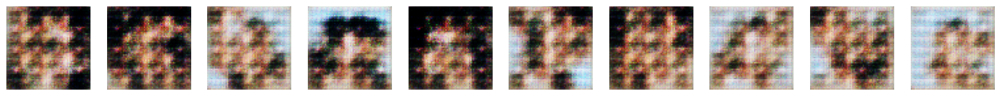

2/2 [==============================] - 2s 1s/step - c_loss: -14.5254 - c_wass_loss: -16.8708 - c_gp: 0.2345 - g_loss: -35.9505 - c_generated_loss: 34.9553 - c_real_loss: -51.8261
Epoch 4/200
2/2 [==============================] - ETA: 0s - c_loss: -17.3993 - c_wass_loss: -20.8151 - c_gp: 0.3416 - g_loss: -42.7834 - c_generated_loss: 45.0274 - c_real_loss: -65.8424
Saved to ./output/generated_img_003.png


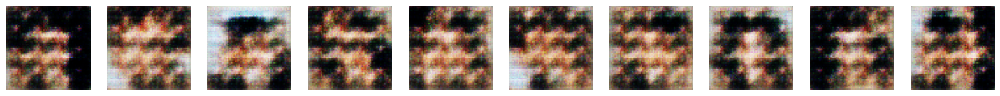

2/2 [==============================] - 2s 1s/step - c_loss: -17.3993 - c_wass_loss: -20.8151 - c_gp: 0.3416 - g_loss: -42.7834 - c_generated_loss: 45.0274 - c_real_loss: -65.8424
Epoch 5/200
2/2 [==============================] - ETA: 0s - c_loss: -19.9223 - c_wass_loss: -23.9566 - c_gp: 0.4034 - g_loss: -22.9913 - c_generated_loss: 25.7611 - c_real_loss: -49.7178
Saved to ./output/generated_img_004.png


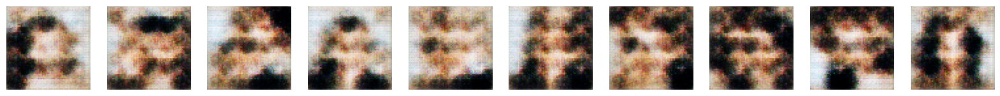

2/2 [==============================] - 1s 951ms/step - c_loss: -19.9223 - c_wass_loss: -23.9566 - c_gp: 0.4034 - g_loss: -22.9913 - c_generated_loss: 25.7611 - c_real_loss: -49.7178
Epoch 6/200
2/2 [==============================] - ETA: 0s - c_loss: -15.1886 - c_wass_loss: -18.8245 - c_gp: 0.3636 - g_loss: -18.5456 - c_generated_loss: 20.7030 - c_real_loss: -39.5275
Saved to ./output/generated_img_005.png


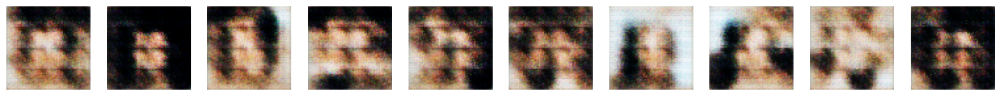

2/2 [==============================] - 1s 919ms/step - c_loss: -15.1886 - c_wass_loss: -18.8245 - c_gp: 0.3636 - g_loss: -18.5456 - c_generated_loss: 20.7030 - c_real_loss: -39.5275
Epoch 7/200
2/2 [==============================] - ETA: 0s - c_loss: -13.8665 - c_wass_loss: -16.4831 - c_gp: 0.2617 - g_loss: -8.2081 - c_generated_loss: 11.2756 - c_real_loss: -27.7587
Saved to ./output/generated_img_006.png


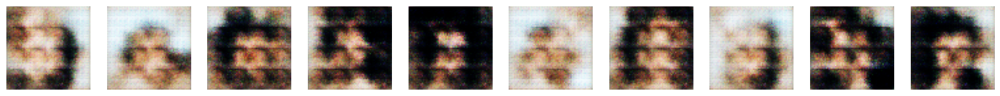

2/2 [==============================] - 1s 927ms/step - c_loss: -13.8665 - c_wass_loss: -16.4831 - c_gp: 0.2617 - g_loss: -8.2081 - c_generated_loss: 11.2756 - c_real_loss: -27.7587
Epoch 8/200
2/2 [==============================] - ETA: 0s - c_loss: -16.9291 - c_wass_loss: -20.3722 - c_gp: 0.3443 - g_loss: 5.7428 - c_generated_loss: -1.7398 - c_real_loss: -18.6323
Saved to ./output/generated_img_007.png


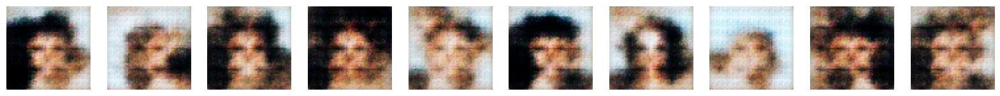

2/2 [==============================] - 1s 926ms/step - c_loss: -16.9291 - c_wass_loss: -20.3722 - c_gp: 0.3443 - g_loss: 5.7428 - c_generated_loss: -1.7398 - c_real_loss: -18.6323
Epoch 9/200
2/2 [==============================] - ETA: 0s - c_loss: -15.6945 - c_wass_loss: -19.0615 - c_gp: 0.3367 - g_loss: -11.7142 - c_generated_loss: 7.6029 - c_real_loss: -26.6644
Saved to ./output/generated_img_008.png


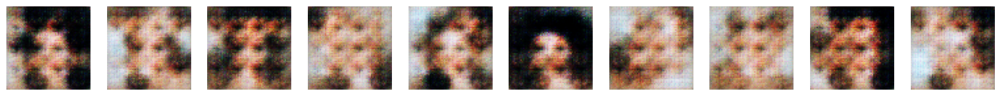

2/2 [==============================] - 1s 924ms/step - c_loss: -15.6945 - c_wass_loss: -19.0615 - c_gp: 0.3367 - g_loss: -11.7142 - c_generated_loss: 7.6029 - c_real_loss: -26.6644
Epoch 10/200
2/2 [==============================] - ETA: 0s - c_loss: -14.3267 - c_wass_loss: -17.2788 - c_gp: 0.2952 - g_loss: -24.7336 - c_generated_loss: 22.8235 - c_real_loss: -40.1023
Saved to ./output/generated_img_009.png


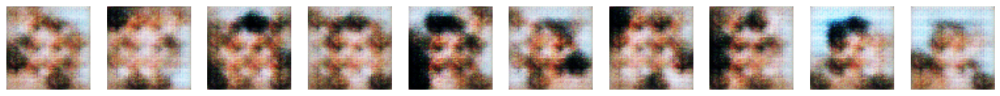

2/2 [==============================] - 2s 1s/step - c_loss: -14.3267 - c_wass_loss: -17.2788 - c_gp: 0.2952 - g_loss: -24.7336 - c_generated_loss: 22.8235 - c_real_loss: -40.1023
Epoch 11/200
2/2 [==============================] - ETA: 0s - c_loss: -17.8867 - c_wass_loss: -21.6086 - c_gp: 0.3722 - g_loss: -40.2278 - c_generated_loss: 41.2613 - c_real_loss: -62.8699
Saved to ./output/generated_img_010.png


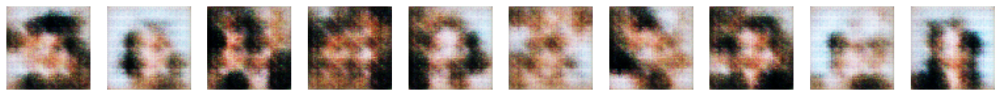

2/2 [==============================] - 1s 939ms/step - c_loss: -17.8867 - c_wass_loss: -21.6086 - c_gp: 0.3722 - g_loss: -40.2278 - c_generated_loss: 41.2613 - c_real_loss: -62.8699
Epoch 12/200
2/2 [==============================] - ETA: 0s - c_loss: -17.4884 - c_wass_loss: -21.9221 - c_gp: 0.4434 - g_loss: -38.1623 - c_generated_loss: 37.3980 - c_real_loss: -59.3201
Saved to ./output/generated_img_011.png


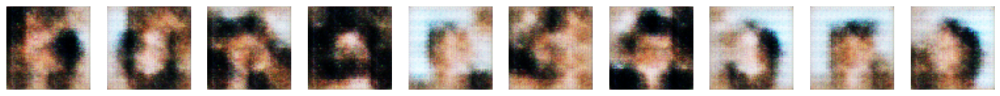

2/2 [==============================] - 2s 1s/step - c_loss: -17.4884 - c_wass_loss: -21.9221 - c_gp: 0.4434 - g_loss: -38.1623 - c_generated_loss: 37.3980 - c_real_loss: -59.3201
Epoch 13/200
2/2 [==============================] - ETA: 0s - c_loss: -14.1177 - c_wass_loss: -17.2180 - c_gp: 0.3100 - g_loss: -26.2345 - c_generated_loss: 30.4587 - c_real_loss: -47.6767
Saved to ./output/generated_img_012.png


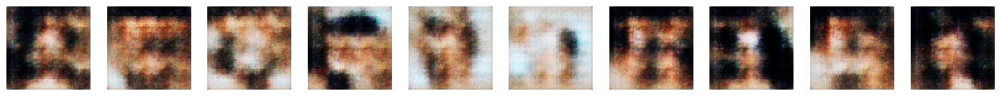

2/2 [==============================] - 2s 1s/step - c_loss: -14.1177 - c_wass_loss: -17.2180 - c_gp: 0.3100 - g_loss: -26.2345 - c_generated_loss: 30.4587 - c_real_loss: -47.6767
Epoch 14/200
2/2 [==============================] - ETA: 0s - c_loss: -14.5012 - c_wass_loss: -17.1185 - c_gp: 0.2617 - g_loss: -39.0593 - c_generated_loss: 37.3783 - c_real_loss: -54.4968
Saved to ./output/generated_img_013.png


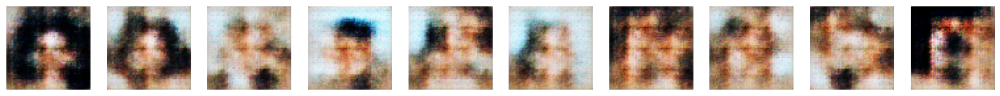

2/2 [==============================] - 2s 1s/step - c_loss: -14.5012 - c_wass_loss: -17.1185 - c_gp: 0.2617 - g_loss: -39.0593 - c_generated_loss: 37.3783 - c_real_loss: -54.4968
Epoch 15/200
2/2 [==============================] - ETA: 0s - c_loss: -16.8394 - c_wass_loss: -19.5878 - c_gp: 0.2748 - g_loss: -24.6843 - c_generated_loss: 26.9096 - c_real_loss: -46.4974
Saved to ./output/generated_img_014.png


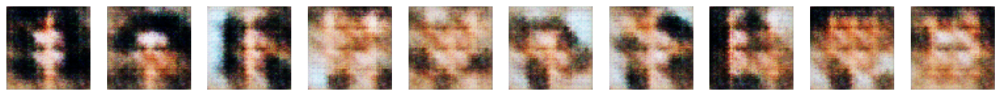

2/2 [==============================] - 2s 1s/step - c_loss: -16.8394 - c_wass_loss: -19.5878 - c_gp: 0.2748 - g_loss: -24.6843 - c_generated_loss: 26.9096 - c_real_loss: -46.4974
Epoch 16/200
2/2 [==============================] - ETA: 0s - c_loss: -15.2181 - c_wass_loss: -18.1779 - c_gp: 0.2960 - g_loss: -40.2712 - c_generated_loss: 38.4231 - c_real_loss: -56.6010
Saved to ./output/generated_img_015.png


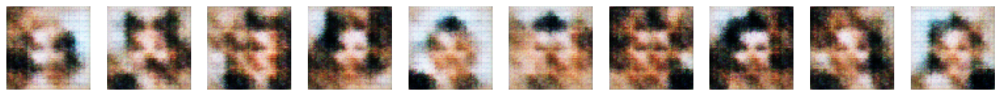

2/2 [==============================] - 2s 1s/step - c_loss: -15.2181 - c_wass_loss: -18.1779 - c_gp: 0.2960 - g_loss: -40.2712 - c_generated_loss: 38.4231 - c_real_loss: -56.6010
Epoch 17/200
2/2 [==============================] - ETA: 0s - c_loss: -13.7744 - c_wass_loss: -15.9701 - c_gp: 0.2196 - g_loss: -26.7434 - c_generated_loss: 28.3285 - c_real_loss: -44.2987
Saved to ./output/generated_img_016.png


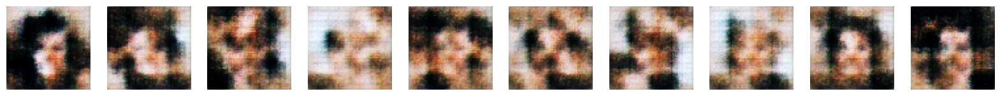

2/2 [==============================] - 2s 1s/step - c_loss: -13.7744 - c_wass_loss: -15.9701 - c_gp: 0.2196 - g_loss: -26.7434 - c_generated_loss: 28.3285 - c_real_loss: -44.2987
Epoch 18/200
2/2 [==============================] - ETA: 0s - c_loss: -17.0182 - c_wass_loss: -20.4296 - c_gp: 0.3411 - g_loss: -29.7360 - c_generated_loss: 30.9771 - c_real_loss: -51.4066
Saved to ./output/generated_img_017.png


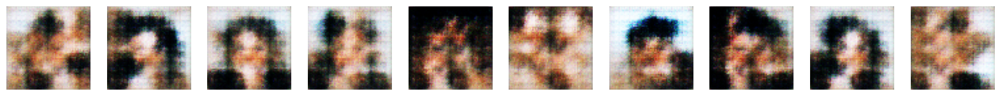

2/2 [==============================] - 2s 1s/step - c_loss: -17.0182 - c_wass_loss: -20.4296 - c_gp: 0.3411 - g_loss: -29.7360 - c_generated_loss: 30.9771 - c_real_loss: -51.4066
Epoch 19/200
2/2 [==============================] - ETA: 0s - c_loss: -14.4652 - c_wass_loss: -17.9478 - c_gp: 0.3483 - g_loss: -27.3753 - c_generated_loss: 27.6211 - c_real_loss: -45.5690
Saved to ./output/generated_img_018.png


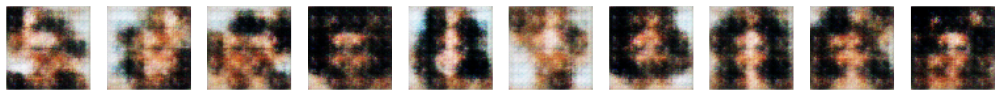

2/2 [==============================] - 2s 1s/step - c_loss: -14.4652 - c_wass_loss: -17.9478 - c_gp: 0.3483 - g_loss: -27.3753 - c_generated_loss: 27.6211 - c_real_loss: -45.5690
Epoch 20/200
2/2 [==============================] - ETA: 0s - c_loss: -14.9978 - c_wass_loss: -17.6482 - c_gp: 0.2650 - g_loss: -26.5523 - c_generated_loss: 26.8230 - c_real_loss: -44.4712
Saved to ./output/generated_img_019.png


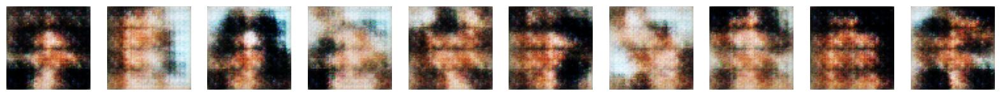

2/2 [==============================] - 2s 1s/step - c_loss: -14.9978 - c_wass_loss: -17.6482 - c_gp: 0.2650 - g_loss: -26.5523 - c_generated_loss: 26.8230 - c_real_loss: -44.4712
Epoch 21/200
2/2 [==============================] - ETA: 0s - c_loss: -16.5765 - c_wass_loss: -19.9639 - c_gp: 0.3387 - g_loss: -32.4574 - c_generated_loss: 35.5735 - c_real_loss: -55.5374
Saved to ./output/generated_img_020.png


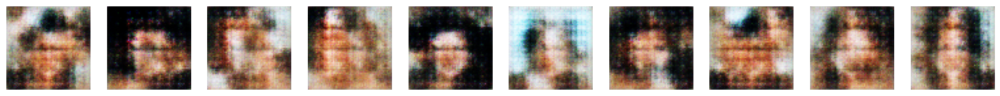

2/2 [==============================] - 2s 1s/step - c_loss: -16.5765 - c_wass_loss: -19.9639 - c_gp: 0.3387 - g_loss: -32.4574 - c_generated_loss: 35.5735 - c_real_loss: -55.5374
Epoch 22/200
2/2 [==============================] - ETA: 0s - c_loss: -15.3754 - c_wass_loss: -18.5379 - c_gp: 0.3162 - g_loss: -30.5575 - c_generated_loss: 30.4800 - c_real_loss: -49.0178
Saved to ./output/generated_img_021.png


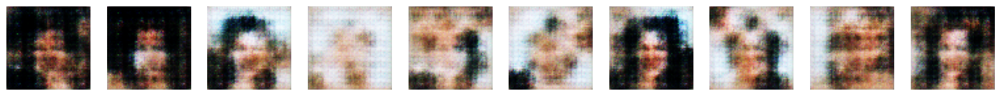

2/2 [==============================] - 2s 1s/step - c_loss: -15.3754 - c_wass_loss: -18.5379 - c_gp: 0.3162 - g_loss: -30.5575 - c_generated_loss: 30.4800 - c_real_loss: -49.0178
Epoch 23/200
2/2 [==============================] - ETA: 0s - c_loss: -14.7424 - c_wass_loss: -17.6400 - c_gp: 0.2898 - g_loss: -29.3067 - c_generated_loss: 30.4253 - c_real_loss: -48.0652
Saved to ./output/generated_img_022.png


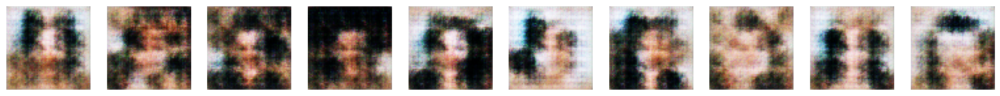

2/2 [==============================] - 2s 1s/step - c_loss: -14.7424 - c_wass_loss: -17.6400 - c_gp: 0.2898 - g_loss: -29.3067 - c_generated_loss: 30.4253 - c_real_loss: -48.0652
Epoch 24/200
2/2 [==============================] - ETA: 0s - c_loss: -13.8745 - c_wass_loss: -16.4242 - c_gp: 0.2550 - g_loss: -26.0012 - c_generated_loss: 22.4657 - c_real_loss: -38.8899
Saved to ./output/generated_img_023.png


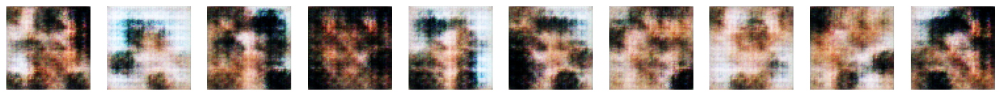

2/2 [==============================] - 2s 1s/step - c_loss: -13.8745 - c_wass_loss: -16.4242 - c_gp: 0.2550 - g_loss: -26.0012 - c_generated_loss: 22.4657 - c_real_loss: -38.8899
Epoch 25/200
2/2 [==============================] - ETA: 0s - c_loss: -15.0663 - c_wass_loss: -17.9426 - c_gp: 0.2876 - g_loss: -46.6527 - c_generated_loss: 48.7723 - c_real_loss: -66.7149
Saved to ./output/generated_img_024.png


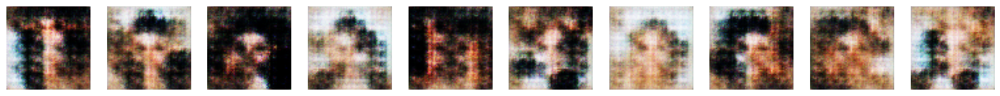

2/2 [==============================] - 2s 1s/step - c_loss: -15.0663 - c_wass_loss: -17.9426 - c_gp: 0.2876 - g_loss: -46.6527 - c_generated_loss: 48.7723 - c_real_loss: -66.7149
Epoch 26/200
2/2 [==============================] - ETA: 0s - c_loss: -15.4044 - c_wass_loss: -18.4953 - c_gp: 0.3091 - g_loss: -24.0008 - c_generated_loss: 24.2429 - c_real_loss: -42.7382
Saved to ./output/generated_img_025.png


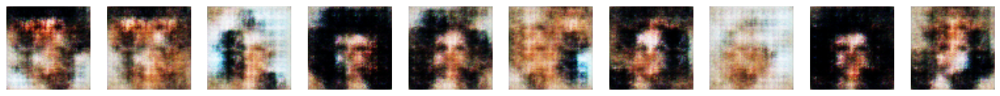

2/2 [==============================] - 2s 1s/step - c_loss: -15.4044 - c_wass_loss: -18.4953 - c_gp: 0.3091 - g_loss: -24.0008 - c_generated_loss: 24.2429 - c_real_loss: -42.7382
Epoch 27/200
2/2 [==============================] - ETA: 0s - c_loss: -13.0836 - c_wass_loss: -15.3684 - c_gp: 0.2285 - g_loss: -13.8351 - c_generated_loss: 16.5299 - c_real_loss: -31.8983
Saved to ./output/generated_img_026.png


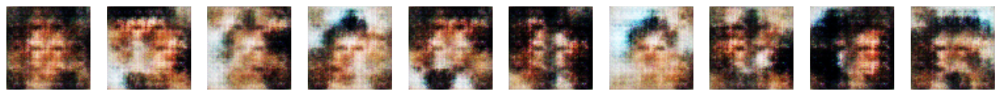

2/2 [==============================] - 2s 1s/step - c_loss: -13.0836 - c_wass_loss: -15.3684 - c_gp: 0.2285 - g_loss: -13.8351 - c_generated_loss: 16.5299 - c_real_loss: -31.8983
Epoch 28/200
2/2 [==============================] - ETA: 0s - c_loss: -13.8478 - c_wass_loss: -16.1159 - c_gp: 0.2268 - g_loss: -32.7173 - c_generated_loss: 32.3182 - c_real_loss: -48.4341
Saved to ./output/generated_img_027.png


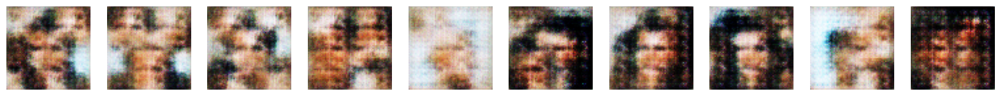

2/2 [==============================] - 2s 1s/step - c_loss: -13.8478 - c_wass_loss: -16.1159 - c_gp: 0.2268 - g_loss: -32.7173 - c_generated_loss: 32.3182 - c_real_loss: -48.4341
Epoch 29/200
2/2 [==============================] - ETA: 0s - c_loss: -13.7404 - c_wass_loss: -15.9681 - c_gp: 0.2228 - g_loss: -19.7615 - c_generated_loss: 20.7847 - c_real_loss: -36.7528
Saved to ./output/generated_img_028.png


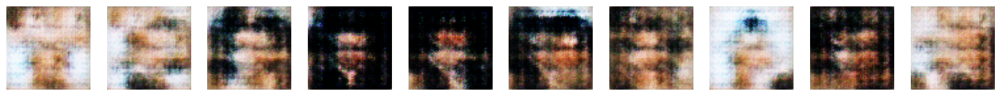

2/2 [==============================] - 2s 1s/step - c_loss: -13.7404 - c_wass_loss: -15.9681 - c_gp: 0.2228 - g_loss: -19.7615 - c_generated_loss: 20.7847 - c_real_loss: -36.7528
Epoch 30/200
2/2 [==============================] - ETA: 0s - c_loss: -14.3885 - c_wass_loss: -17.2575 - c_gp: 0.2869 - g_loss: -40.6922 - c_generated_loss: 39.8796 - c_real_loss: -57.1371
Saved to ./output/generated_img_029.png


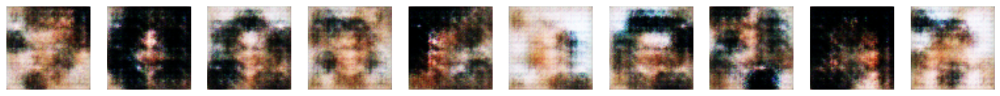

2/2 [==============================] - 2s 1s/step - c_loss: -14.3885 - c_wass_loss: -17.2575 - c_gp: 0.2869 - g_loss: -40.6922 - c_generated_loss: 39.8796 - c_real_loss: -57.1371
Epoch 31/200
2/2 [==============================] - ETA: 0s - c_loss: -12.9133 - c_wass_loss: -15.4690 - c_gp: 0.2556 - g_loss: -34.6366 - c_generated_loss: 36.6757 - c_real_loss: -52.1447
Saved to ./output/generated_img_030.png


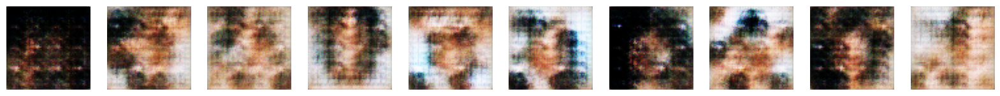

2/2 [==============================] - 2s 1s/step - c_loss: -12.9133 - c_wass_loss: -15.4690 - c_gp: 0.2556 - g_loss: -34.6366 - c_generated_loss: 36.6757 - c_real_loss: -52.1447
Epoch 32/200
2/2 [==============================] - ETA: 0s - c_loss: -14.0802 - c_wass_loss: -16.2605 - c_gp: 0.2180 - g_loss: -24.1590 - c_generated_loss: 26.1006 - c_real_loss: -42.3611
Saved to ./output/generated_img_031.png


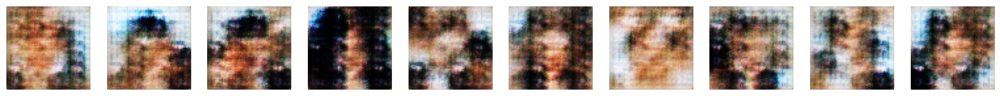

2/2 [==============================] - 2s 1s/step - c_loss: -14.0802 - c_wass_loss: -16.2605 - c_gp: 0.2180 - g_loss: -24.1590 - c_generated_loss: 26.1006 - c_real_loss: -42.3611
Epoch 33/200
2/2 [==============================] - ETA: 0s - c_loss: -15.1011 - c_wass_loss: -17.9494 - c_gp: 0.2848 - g_loss: -26.6223 - c_generated_loss: 22.0964 - c_real_loss: -40.0458
Saved to ./output/generated_img_032.png


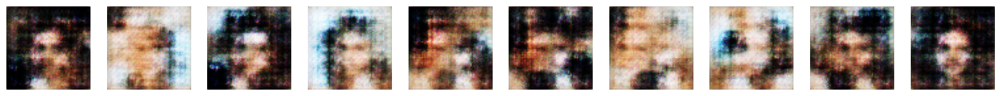

2/2 [==============================] - 2s 1s/step - c_loss: -15.1011 - c_wass_loss: -17.9494 - c_gp: 0.2848 - g_loss: -26.6223 - c_generated_loss: 22.0964 - c_real_loss: -40.0458
Epoch 34/200
2/2 [==============================] - ETA: 0s - c_loss: -13.4359 - c_wass_loss: -15.8464 - c_gp: 0.2411 - g_loss: -35.9637 - c_generated_loss: 37.7600 - c_real_loss: -53.6064
Saved to ./output/generated_img_033.png


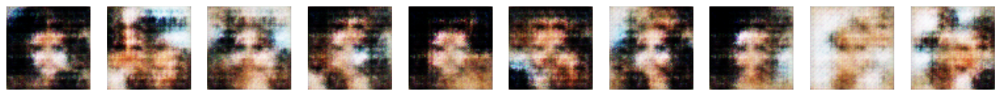

2/2 [==============================] - 2s 1s/step - c_loss: -13.4359 - c_wass_loss: -15.8464 - c_gp: 0.2411 - g_loss: -35.9637 - c_generated_loss: 37.7600 - c_real_loss: -53.6064
Epoch 35/200
2/2 [==============================] - ETA: 0s - c_loss: -12.7000 - c_wass_loss: -14.5632 - c_gp: 0.1863 - g_loss: -25.9711 - c_generated_loss: 27.3096 - c_real_loss: -41.8728
Saved to ./output/generated_img_034.png


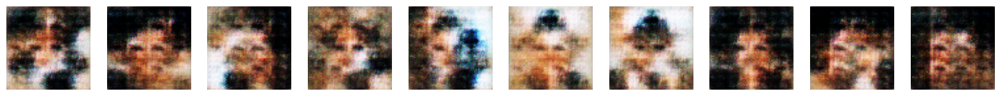

2/2 [==============================] - 2s 1s/step - c_loss: -12.7000 - c_wass_loss: -14.5632 - c_gp: 0.1863 - g_loss: -25.9711 - c_generated_loss: 27.3096 - c_real_loss: -41.8728
Epoch 36/200
2/2 [==============================] - ETA: 0s - c_loss: -13.2602 - c_wass_loss: -15.3565 - c_gp: 0.2096 - g_loss: -34.8776 - c_generated_loss: 35.3701 - c_real_loss: -50.7265
Saved to ./output/generated_img_035.png


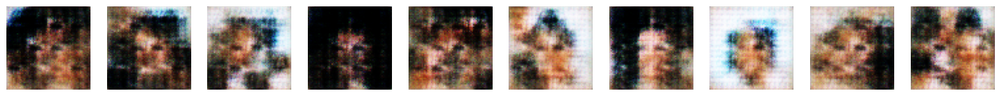

2/2 [==============================] - 2s 1s/step - c_loss: -13.2602 - c_wass_loss: -15.3565 - c_gp: 0.2096 - g_loss: -34.8776 - c_generated_loss: 35.3701 - c_real_loss: -50.7265
Epoch 37/200
2/2 [==============================] - ETA: 0s - c_loss: -14.6814 - c_wass_loss: -17.1920 - c_gp: 0.2511 - g_loss: -22.8669 - c_generated_loss: 25.1516 - c_real_loss: -42.3436
Saved to ./output/generated_img_036.png


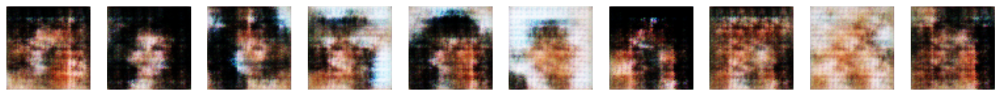

2/2 [==============================] - 2s 1s/step - c_loss: -14.6814 - c_wass_loss: -17.1920 - c_gp: 0.2511 - g_loss: -22.8669 - c_generated_loss: 25.1516 - c_real_loss: -42.3436
Epoch 38/200
2/2 [==============================] - ETA: 0s - c_loss: -15.1305 - c_wass_loss: -18.1432 - c_gp: 0.3013 - g_loss: -28.1053 - c_generated_loss: 28.2911 - c_real_loss: -46.4343
Saved to ./output/generated_img_037.png


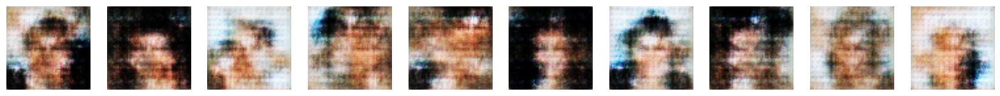

2/2 [==============================] - 2s 1s/step - c_loss: -15.1305 - c_wass_loss: -18.1432 - c_gp: 0.3013 - g_loss: -28.1053 - c_generated_loss: 28.2911 - c_real_loss: -46.4343
Epoch 39/200
2/2 [==============================] - ETA: 0s - c_loss: -14.4208 - c_wass_loss: -17.2005 - c_gp: 0.2780 - g_loss: -35.2454 - c_generated_loss: 37.3929 - c_real_loss: -54.5934
Saved to ./output/generated_img_038.png


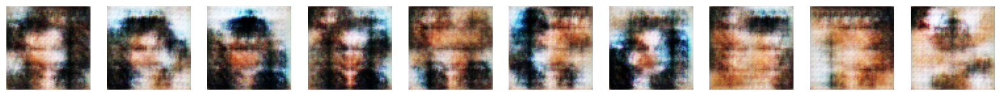

2/2 [==============================] - 2s 1s/step - c_loss: -14.4208 - c_wass_loss: -17.2005 - c_gp: 0.2780 - g_loss: -35.2454 - c_generated_loss: 37.3929 - c_real_loss: -54.5934
Epoch 40/200
2/2 [==============================] - ETA: 0s - c_loss: -12.8480 - c_wass_loss: -15.1978 - c_gp: 0.2350 - g_loss: -41.3902 - c_generated_loss: 38.2030 - c_real_loss: -53.4009
Saved to ./output/generated_img_039.png


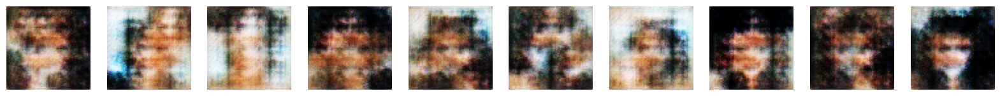

2/2 [==============================] - 2s 1s/step - c_loss: -12.8480 - c_wass_loss: -15.1978 - c_gp: 0.2350 - g_loss: -41.3902 - c_generated_loss: 38.2030 - c_real_loss: -53.4009
Epoch 41/200
2/2 [==============================] - ETA: 0s - c_loss: -12.3037 - c_wass_loss: -14.1216 - c_gp: 0.1818 - g_loss: -64.0750 - c_generated_loss: 61.6937 - c_real_loss: -75.8153
Saved to ./output/generated_img_040.png


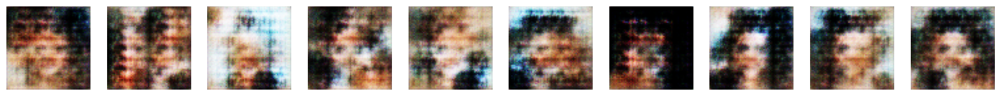

2/2 [==============================] - 2s 1s/step - c_loss: -12.3037 - c_wass_loss: -14.1216 - c_gp: 0.1818 - g_loss: -64.0750 - c_generated_loss: 61.6937 - c_real_loss: -75.8153
Epoch 42/200
2/2 [==============================] - ETA: 0s - c_loss: -13.8144 - c_wass_loss: -16.0930 - c_gp: 0.2279 - g_loss: -47.3085 - c_generated_loss: 51.6663 - c_real_loss: -67.7593
Saved to ./output/generated_img_041.png


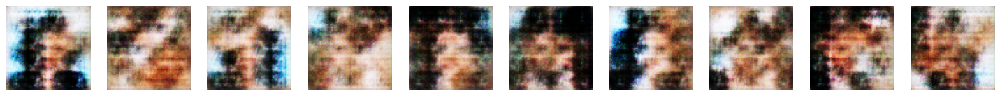

2/2 [==============================] - 2s 1s/step - c_loss: -13.8144 - c_wass_loss: -16.0930 - c_gp: 0.2279 - g_loss: -47.3085 - c_generated_loss: 51.6663 - c_real_loss: -67.7593
Epoch 43/200
2/2 [==============================] - ETA: 0s - c_loss: -14.9291 - c_wass_loss: -17.2669 - c_gp: 0.2338 - g_loss: -33.6004 - c_generated_loss: 35.0108 - c_real_loss: -52.2778
Saved to ./output/generated_img_042.png


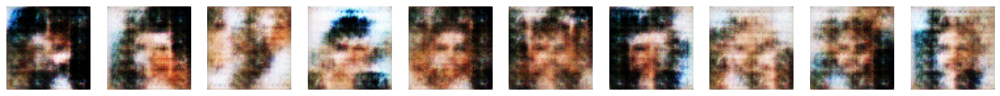

2/2 [==============================] - 2s 1s/step - c_loss: -14.9291 - c_wass_loss: -17.2669 - c_gp: 0.2338 - g_loss: -33.6004 - c_generated_loss: 35.0108 - c_real_loss: -52.2778
Epoch 44/200
2/2 [==============================] - ETA: 0s - c_loss: -14.2104 - c_wass_loss: -17.2014 - c_gp: 0.2991 - g_loss: -35.8102 - c_generated_loss: 35.6138 - c_real_loss: -52.8151
Saved to ./output/generated_img_043.png


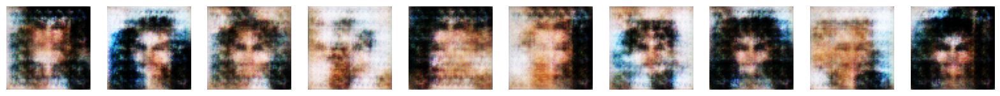

2/2 [==============================] - 2s 1s/step - c_loss: -14.2104 - c_wass_loss: -17.2014 - c_gp: 0.2991 - g_loss: -35.8102 - c_generated_loss: 35.6138 - c_real_loss: -52.8151
Epoch 45/200
2/2 [==============================] - ETA: 0s - c_loss: -13.1219 - c_wass_loss: -15.6192 - c_gp: 0.2497 - g_loss: -42.1749 - c_generated_loss: 44.9161 - c_real_loss: -60.5353
Saved to ./output/generated_img_044.png


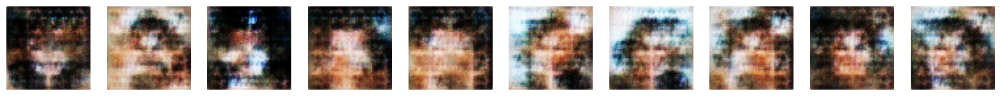

2/2 [==============================] - 2s 1s/step - c_loss: -13.1219 - c_wass_loss: -15.6192 - c_gp: 0.2497 - g_loss: -42.1749 - c_generated_loss: 44.9161 - c_real_loss: -60.5353
Epoch 46/200
2/2 [==============================] - ETA: 0s - c_loss: -14.3680 - c_wass_loss: -16.6491 - c_gp: 0.2281 - g_loss: -37.7838 - c_generated_loss: 36.7843 - c_real_loss: -53.4334
Saved to ./output/generated_img_045.png


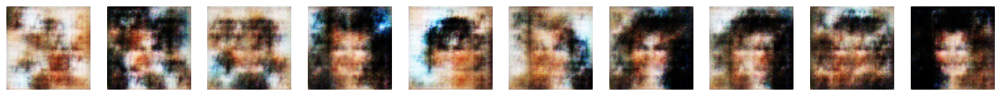

2/2 [==============================] - 2s 1s/step - c_loss: -14.3680 - c_wass_loss: -16.6491 - c_gp: 0.2281 - g_loss: -37.7838 - c_generated_loss: 36.7843 - c_real_loss: -53.4334
Epoch 47/200
2/2 [==============================] - ETA: 0s - c_loss: -14.7130 - c_wass_loss: -17.0965 - c_gp: 0.2383 - g_loss: -38.4385 - c_generated_loss: 38.3706 - c_real_loss: -55.4671
Saved to ./output/generated_img_046.png


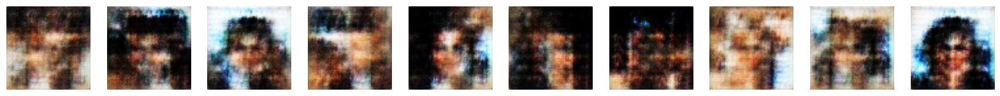

2/2 [==============================] - 2s 1s/step - c_loss: -14.7130 - c_wass_loss: -17.0965 - c_gp: 0.2383 - g_loss: -38.4385 - c_generated_loss: 38.3706 - c_real_loss: -55.4671
Epoch 48/200
2/2 [==============================] - ETA: 0s - c_loss: -14.0590 - c_wass_loss: -16.6258 - c_gp: 0.2567 - g_loss: -54.5626 - c_generated_loss: 53.6035 - c_real_loss: -70.2293
Saved to ./output/generated_img_047.png


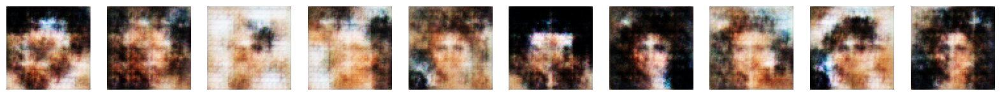

2/2 [==============================] - 2s 1s/step - c_loss: -14.0590 - c_wass_loss: -16.6258 - c_gp: 0.2567 - g_loss: -54.5626 - c_generated_loss: 53.6035 - c_real_loss: -70.2293
Epoch 49/200
2/2 [==============================] - ETA: 0s - c_loss: -14.4847 - c_wass_loss: -17.1360 - c_gp: 0.2651 - g_loss: -56.3571 - c_generated_loss: 57.8938 - c_real_loss: -75.0298
Saved to ./output/generated_img_048.png


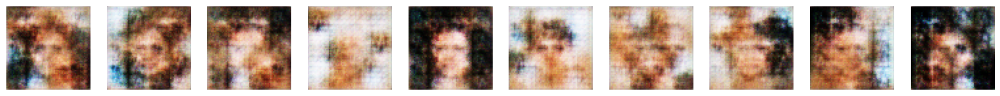

2/2 [==============================] - 2s 1s/step - c_loss: -14.4847 - c_wass_loss: -17.1360 - c_gp: 0.2651 - g_loss: -56.3571 - c_generated_loss: 57.8938 - c_real_loss: -75.0298
Epoch 50/200
2/2 [==============================] - ETA: 0s - c_loss: -14.1723 - c_wass_loss: -16.9228 - c_gp: 0.2750 - g_loss: -40.8811 - c_generated_loss: 41.1327 - c_real_loss: -58.0555
Saved to ./output/generated_img_049.png


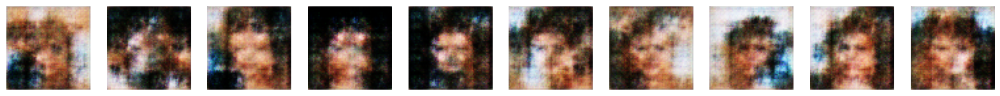

2/2 [==============================] - 2s 1s/step - c_loss: -14.1723 - c_wass_loss: -16.9228 - c_gp: 0.2750 - g_loss: -40.8811 - c_generated_loss: 41.1327 - c_real_loss: -58.0555
Epoch 51/200
2/2 [==============================] - ETA: 0s - c_loss: -13.0430 - c_wass_loss: -15.3926 - c_gp: 0.2350 - g_loss: -57.2365 - c_generated_loss: 57.0773 - c_real_loss: -72.4699
Saved to ./output/generated_img_050.png


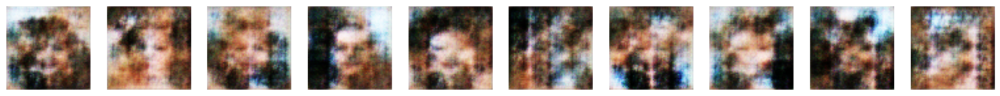

2/2 [==============================] - 2s 1s/step - c_loss: -13.0430 - c_wass_loss: -15.3926 - c_gp: 0.2350 - g_loss: -57.2365 - c_generated_loss: 57.0773 - c_real_loss: -72.4699
Epoch 52/200
2/2 [==============================] - ETA: 0s - c_loss: -13.4432 - c_wass_loss: -15.4909 - c_gp: 0.2048 - g_loss: -58.0555 - c_generated_loss: 60.5424 - c_real_loss: -76.0333
Saved to ./output/generated_img_051.png


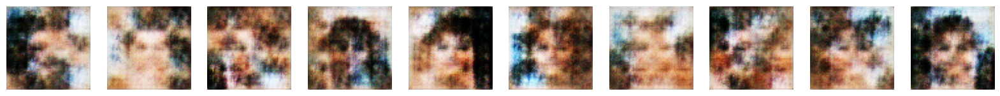

2/2 [==============================] - 2s 1s/step - c_loss: -13.4432 - c_wass_loss: -15.4909 - c_gp: 0.2048 - g_loss: -58.0555 - c_generated_loss: 60.5424 - c_real_loss: -76.0333
Epoch 53/200
2/2 [==============================] - ETA: 0s - c_loss: -14.5555 - c_wass_loss: -16.7967 - c_gp: 0.2241 - g_loss: -45.5299 - c_generated_loss: 45.3480 - c_real_loss: -62.1446
Saved to ./output/generated_img_052.png


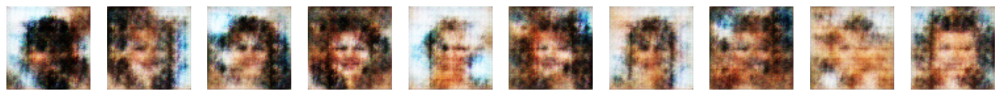

2/2 [==============================] - 2s 1s/step - c_loss: -14.5555 - c_wass_loss: -16.7967 - c_gp: 0.2241 - g_loss: -45.5299 - c_generated_loss: 45.3480 - c_real_loss: -62.1446
Epoch 54/200
2/2 [==============================] - ETA: 0s - c_loss: -15.5319 - c_wass_loss: -19.0222 - c_gp: 0.3490 - g_loss: -61.5379 - c_generated_loss: 59.0636 - c_real_loss: -78.0858
Saved to ./output/generated_img_053.png


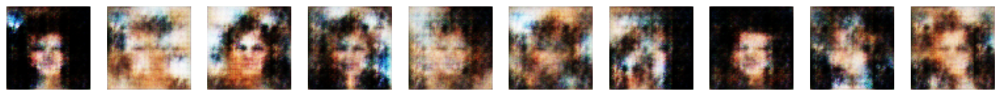

2/2 [==============================] - 2s 1s/step - c_loss: -15.5319 - c_wass_loss: -19.0222 - c_gp: 0.3490 - g_loss: -61.5379 - c_generated_loss: 59.0636 - c_real_loss: -78.0858
Epoch 55/200
2/2 [==============================] - ETA: 0s - c_loss: -13.6777 - c_wass_loss: -16.3956 - c_gp: 0.2718 - g_loss: -55.2666 - c_generated_loss: 60.2309 - c_real_loss: -76.6265
Saved to ./output/generated_img_054.png


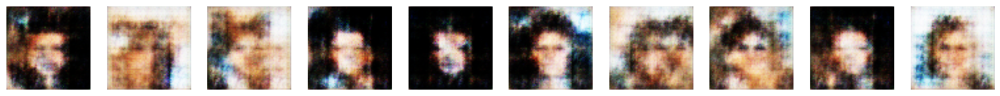

2/2 [==============================] - 2s 1s/step - c_loss: -13.6777 - c_wass_loss: -16.3956 - c_gp: 0.2718 - g_loss: -55.2666 - c_generated_loss: 60.2309 - c_real_loss: -76.6265
Epoch 56/200
2/2 [==============================] - ETA: 0s - c_loss: -13.3802 - c_wass_loss: -15.8735 - c_gp: 0.2493 - g_loss: -52.4185 - c_generated_loss: 52.6434 - c_real_loss: -68.5169
Saved to ./output/generated_img_055.png


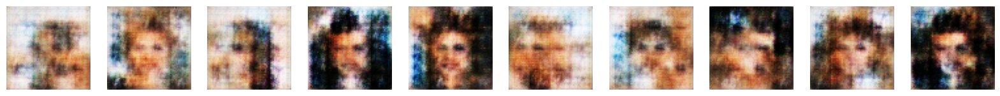

2/2 [==============================] - 2s 1s/step - c_loss: -13.3802 - c_wass_loss: -15.8735 - c_gp: 0.2493 - g_loss: -52.4185 - c_generated_loss: 52.6434 - c_real_loss: -68.5169
Epoch 57/200
2/2 [==============================] - ETA: 0s - c_loss: -14.6671 - c_wass_loss: -17.2017 - c_gp: 0.2535 - g_loss: -60.7930 - c_generated_loss: 60.1657 - c_real_loss: -77.3674
Saved to ./output/generated_img_056.png


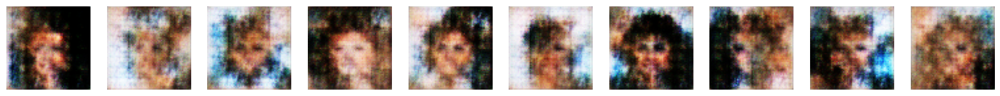

2/2 [==============================] - 2s 1s/step - c_loss: -14.6671 - c_wass_loss: -17.2017 - c_gp: 0.2535 - g_loss: -60.7930 - c_generated_loss: 60.1657 - c_real_loss: -77.3674
Epoch 58/200
2/2 [==============================] - ETA: 0s - c_loss: -14.6457 - c_wass_loss: -17.3636 - c_gp: 0.2718 - g_loss: -71.7289 - c_generated_loss: 70.9393 - c_real_loss: -88.3029
Saved to ./output/generated_img_057.png


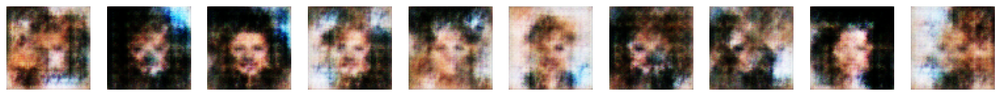

2/2 [==============================] - 2s 1s/step - c_loss: -14.6457 - c_wass_loss: -17.3636 - c_gp: 0.2718 - g_loss: -71.7289 - c_generated_loss: 70.9393 - c_real_loss: -88.3029
Epoch 59/200
2/2 [==============================] - ETA: 0s - c_loss: -14.5022 - c_wass_loss: -17.3539 - c_gp: 0.2852 - g_loss: -72.8965 - c_generated_loss: 72.0699 - c_real_loss: -89.4238
Saved to ./output/generated_img_058.png


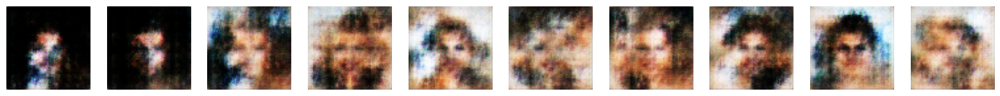

2/2 [==============================] - 2s 1s/step - c_loss: -14.5022 - c_wass_loss: -17.3539 - c_gp: 0.2852 - g_loss: -72.8965 - c_generated_loss: 72.0699 - c_real_loss: -89.4238
Epoch 60/200
2/2 [==============================] - ETA: 0s - c_loss: -14.8755 - c_wass_loss: -17.7575 - c_gp: 0.2882 - g_loss: -57.3732 - c_generated_loss: 56.6683 - c_real_loss: -74.4258
Saved to ./output/generated_img_059.png


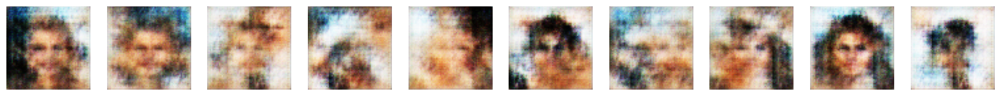

2/2 [==============================] - 2s 1s/step - c_loss: -14.8755 - c_wass_loss: -17.7575 - c_gp: 0.2882 - g_loss: -57.3732 - c_generated_loss: 56.6683 - c_real_loss: -74.4258
Epoch 61/200
2/2 [==============================] - ETA: 0s - c_loss: -13.1852 - c_wass_loss: -15.8192 - c_gp: 0.2634 - g_loss: -60.5483 - c_generated_loss: 61.0139 - c_real_loss: -76.8331
Saved to ./output/generated_img_060.png


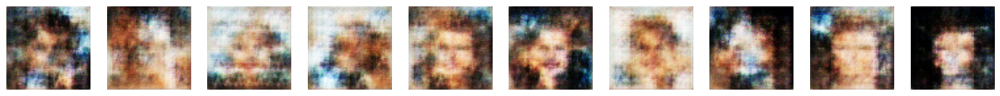

2/2 [==============================] - 2s 1s/step - c_loss: -13.1852 - c_wass_loss: -15.8192 - c_gp: 0.2634 - g_loss: -60.5483 - c_generated_loss: 61.0139 - c_real_loss: -76.8331
Epoch 62/200
2/2 [==============================] - ETA: 0s - c_loss: -14.8017 - c_wass_loss: -17.5387 - c_gp: 0.2737 - g_loss: -81.0729 - c_generated_loss: 80.3571 - c_real_loss: -97.8958
Saved to ./output/generated_img_061.png


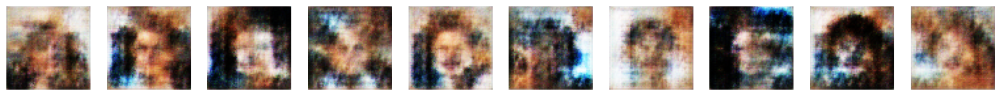

2/2 [==============================] - 2s 1s/step - c_loss: -14.8017 - c_wass_loss: -17.5387 - c_gp: 0.2737 - g_loss: -81.0729 - c_generated_loss: 80.3571 - c_real_loss: -97.8958
Epoch 63/200
2/2 [==============================] - ETA: 0s - c_loss: -14.7060 - c_wass_loss: -17.7827 - c_gp: 0.3077 - g_loss: -64.3866 - c_generated_loss: 65.6508 - c_real_loss: -83.4335
Saved to ./output/generated_img_062.png


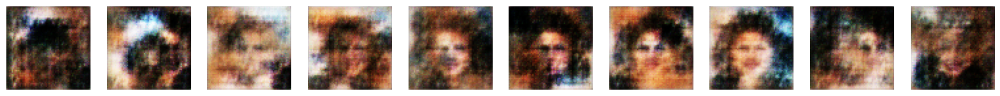

2/2 [==============================] - 2s 1s/step - c_loss: -14.7060 - c_wass_loss: -17.7827 - c_gp: 0.3077 - g_loss: -64.3866 - c_generated_loss: 65.6508 - c_real_loss: -83.4335
Epoch 64/200
2/2 [==============================] - ETA: 0s - c_loss: -15.2187 - c_wass_loss: -18.1373 - c_gp: 0.2919 - g_loss: -62.8969 - c_generated_loss: 60.6800 - c_real_loss: -78.8173
Saved to ./output/generated_img_063.png


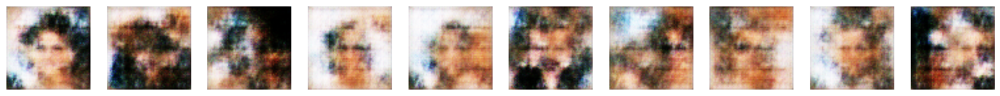

2/2 [==============================] - 2s 1s/step - c_loss: -15.2187 - c_wass_loss: -18.1373 - c_gp: 0.2919 - g_loss: -62.8969 - c_generated_loss: 60.6800 - c_real_loss: -78.8173
Epoch 65/200
2/2 [==============================] - ETA: 0s - c_loss: -14.6440 - c_wass_loss: -17.4693 - c_gp: 0.2825 - g_loss: -66.0705 - c_generated_loss: 67.0198 - c_real_loss: -84.4891
Saved to ./output/generated_img_064.png


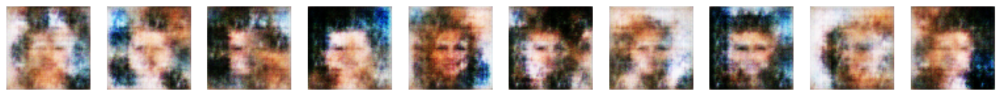

2/2 [==============================] - 2s 1s/step - c_loss: -14.6440 - c_wass_loss: -17.4693 - c_gp: 0.2825 - g_loss: -66.0705 - c_generated_loss: 67.0198 - c_real_loss: -84.4891
Epoch 66/200
2/2 [==============================] - ETA: 0s - c_loss: -14.1798 - c_wass_loss: -16.6613 - c_gp: 0.2482 - g_loss: -61.0324 - c_generated_loss: 59.6749 - c_real_loss: -76.3362
Saved to ./output/generated_img_065.png


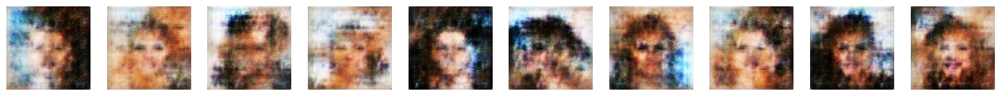

2/2 [==============================] - 2s 1s/step - c_loss: -14.1798 - c_wass_loss: -16.6613 - c_gp: 0.2482 - g_loss: -61.0324 - c_generated_loss: 59.6749 - c_real_loss: -76.3362
Epoch 67/200
2/2 [==============================] - ETA: 0s - c_loss: -13.7459 - c_wass_loss: -16.1766 - c_gp: 0.2431 - g_loss: -79.3179 - c_generated_loss: 76.1263 - c_real_loss: -92.3029
Saved to ./output/generated_img_066.png


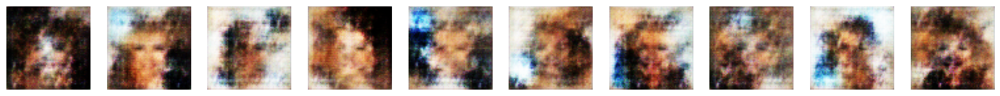

2/2 [==============================] - 2s 1s/step - c_loss: -13.7459 - c_wass_loss: -16.1766 - c_gp: 0.2431 - g_loss: -79.3179 - c_generated_loss: 76.1263 - c_real_loss: -92.3029
Epoch 68/200
2/2 [==============================] - ETA: 0s - c_loss: -13.5247 - c_wass_loss: -15.8606 - c_gp: 0.2336 - g_loss: -64.4792 - c_generated_loss: 69.7872 - c_real_loss: -85.6477
Saved to ./output/generated_img_067.png


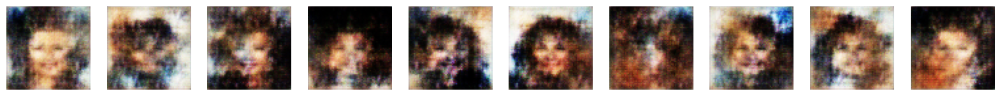

2/2 [==============================] - 1s 940ms/step - c_loss: -13.5247 - c_wass_loss: -15.8606 - c_gp: 0.2336 - g_loss: -64.4792 - c_generated_loss: 69.7872 - c_real_loss: -85.6477
Epoch 69/200
2/2 [==============================] - ETA: 0s - c_loss: -14.1003 - c_wass_loss: -16.5077 - c_gp: 0.2407 - g_loss: -75.3828 - c_generated_loss: 71.9207 - c_real_loss: -88.4284
Saved to ./output/generated_img_068.png


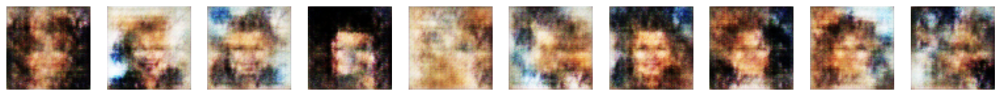

2/2 [==============================] - 1s 925ms/step - c_loss: -14.1003 - c_wass_loss: -16.5077 - c_gp: 0.2407 - g_loss: -75.3828 - c_generated_loss: 71.9207 - c_real_loss: -88.4284
Epoch 70/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_069.png


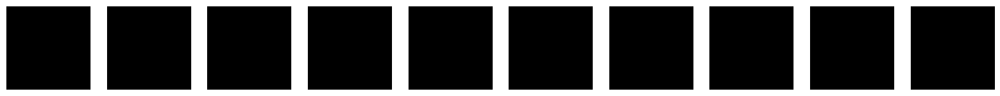

2/2 [==============================] - 1s 810ms/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 71/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_070.png


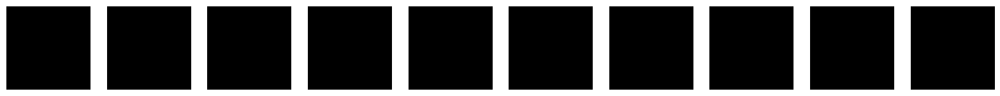

2/2 [==============================] - 2s 1s/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 72/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_071.png


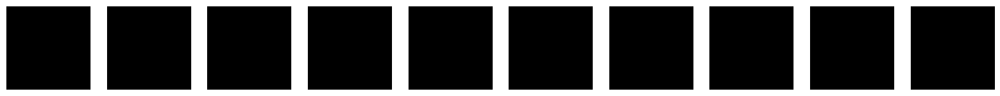

2/2 [==============================] - 2s 1s/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 73/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_072.png


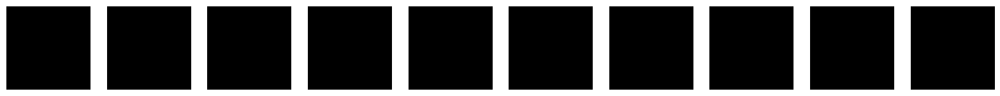

2/2 [==============================] - 2s 993ms/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 74/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_073.png


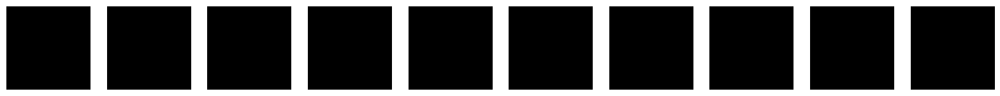

2/2 [==============================] - 1s 813ms/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 75/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_074.png


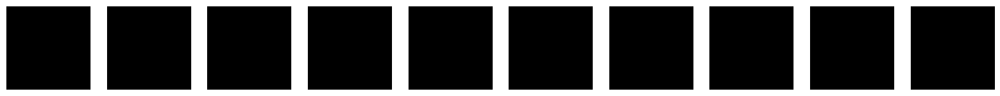

2/2 [==============================] - 1s 801ms/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 76/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_075.png


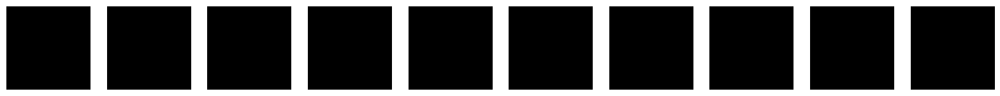

2/2 [==============================] - 2s 1s/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 77/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_076.png


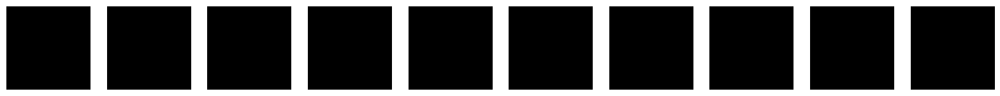

2/2 [==============================] - 1s 819ms/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 78/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_077.png


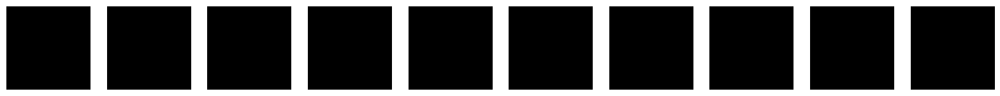

2/2 [==============================] - 1s 814ms/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 79/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_078.png


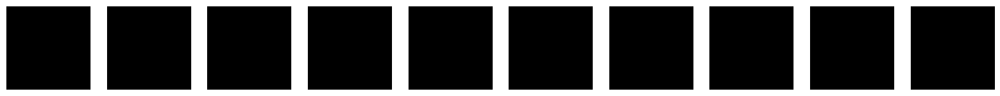

2/2 [==============================] - 1s 828ms/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 80/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_079.png


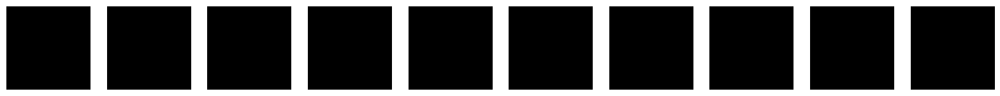

2/2 [==============================] - 1s 822ms/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 81/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_080.png


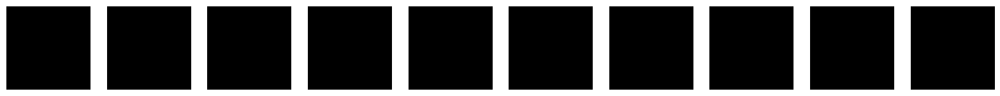

2/2 [==============================] - 1s 824ms/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 82/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_081.png


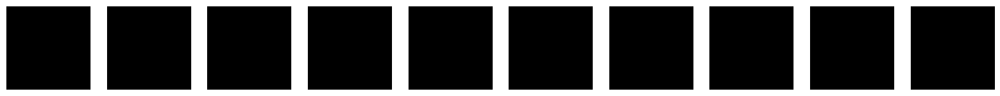

2/2 [==============================] - 1s 834ms/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 83/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_082.png


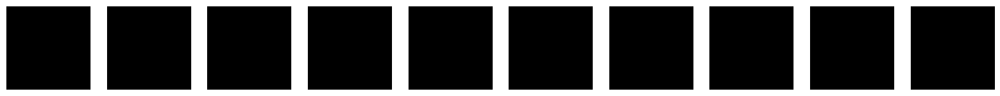

2/2 [==============================] - 1s 809ms/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 84/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_083.png


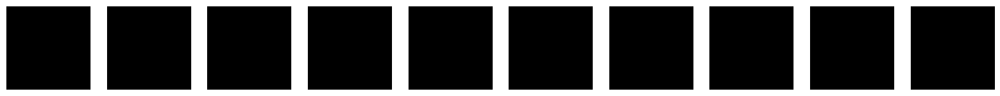

2/2 [==============================] - 1s 815ms/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 85/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_084.png


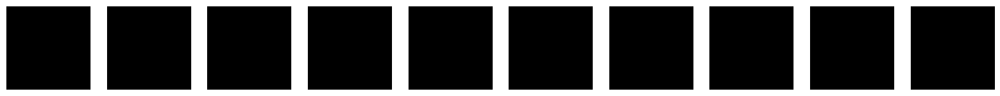

2/2 [==============================] - 1s 820ms/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 86/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_085.png


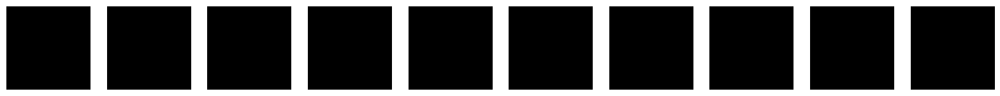

2/2 [==============================] - 1s 804ms/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 87/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_086.png


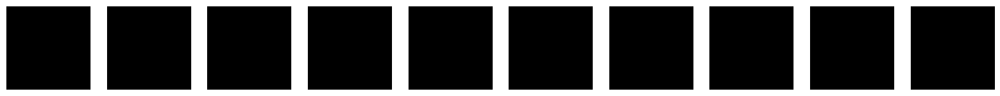

2/2 [==============================] - 2s 1s/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 88/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_087.png


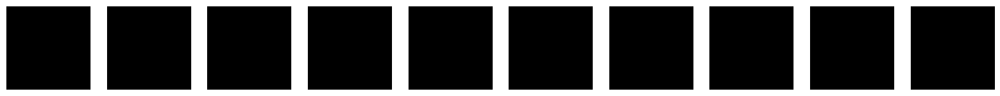

2/2 [==============================] - 1s 819ms/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 89/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_088.png


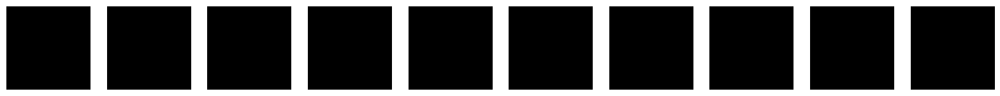

2/2 [==============================] - 1s 837ms/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 90/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_089.png


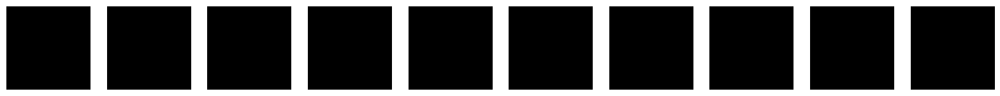

2/2 [==============================] - 1s 812ms/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 91/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_090.png


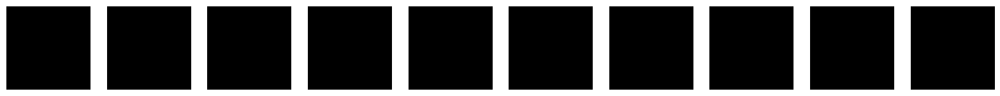

2/2 [==============================] - 1s 824ms/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 92/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_091.png


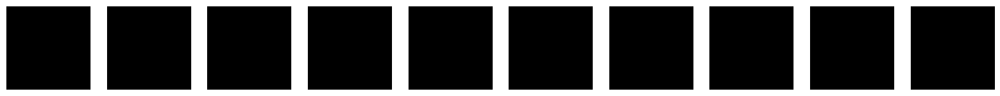

2/2 [==============================] - 1s 825ms/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 93/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_092.png


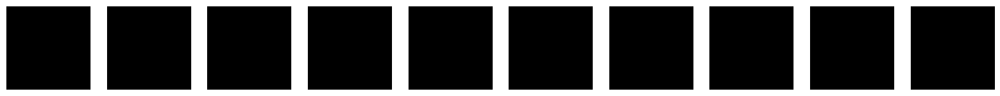

2/2 [==============================] - 1s 815ms/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 94/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_093.png


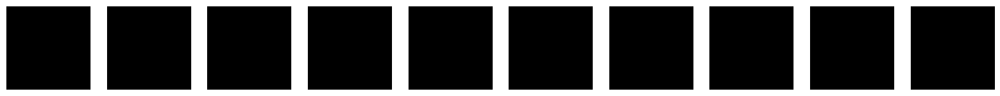

2/2 [==============================] - 1s 806ms/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 95/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_094.png


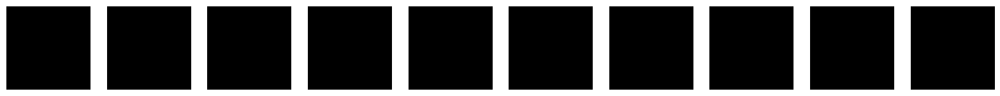

2/2 [==============================] - 1s 803ms/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 96/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_095.png


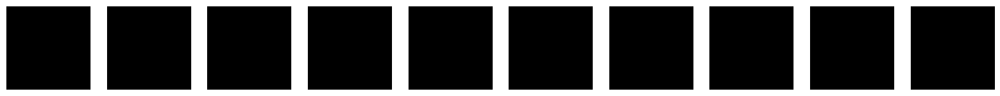

2/2 [==============================] - 1s 816ms/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 97/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_096.png


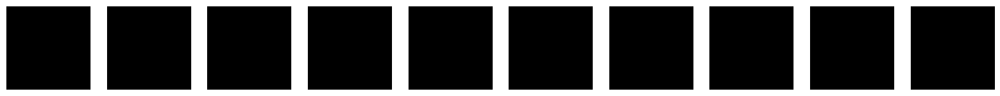

2/2 [==============================] - 1s 809ms/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 98/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_097.png


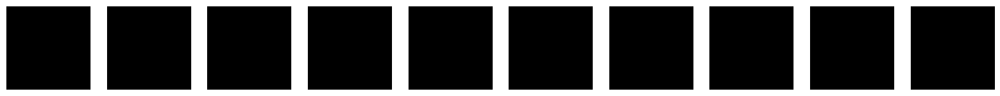

2/2 [==============================] - 2s 1s/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 99/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_098.png


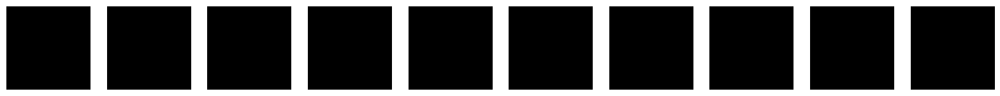

2/2 [==============================] - 2s 1s/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 100/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_099.png


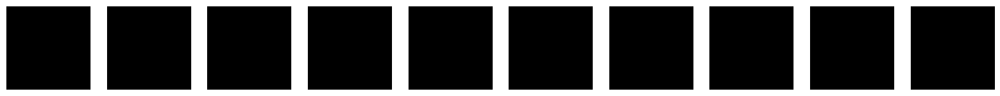

2/2 [==============================] - 2s 1s/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 101/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_100.png


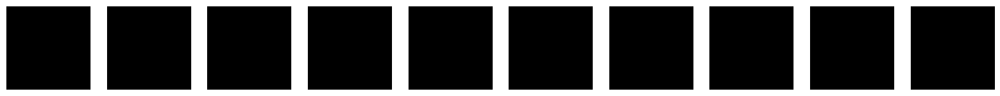

2/2 [==============================] - 1s 824ms/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 102/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_101.png


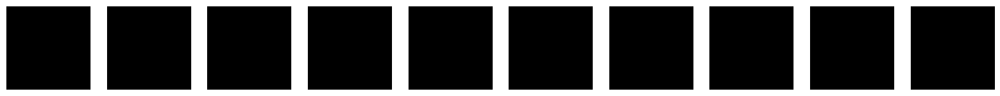

2/2 [==============================] - 1s 826ms/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 103/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_102.png


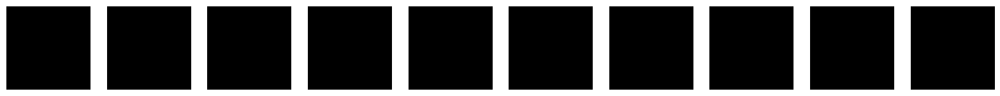

2/2 [==============================] - 1s 805ms/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 104/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_103.png


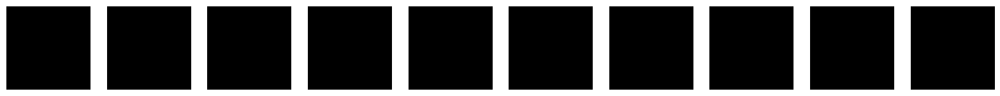

2/2 [==============================] - 2s 1s/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 105/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_104.png


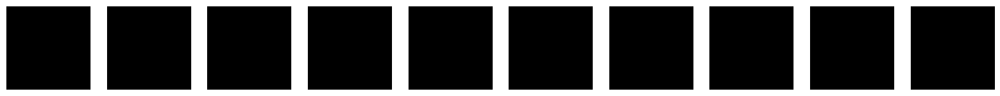

2/2 [==============================] - 2s 1s/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 106/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_105.png


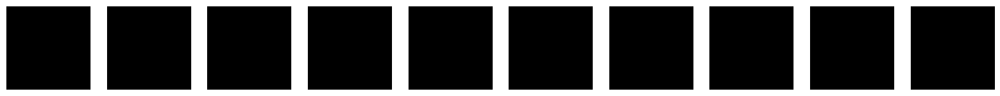

2/2 [==============================] - 2s 1s/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 107/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_106.png


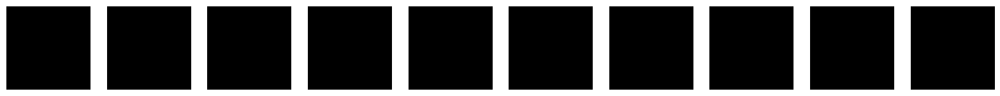

2/2 [==============================] - 2s 1s/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 108/200
2/2 [==============================] - ETA: 0s - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Saved to ./output/generated_img_107.png


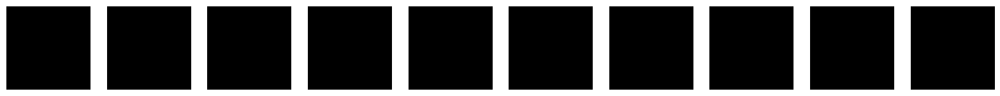

2/2 [==============================] - 2s 1s/step - c_loss: nan - c_wass_loss: nan - c_gp: nan - g_loss: nan - c_generated_loss: nan - c_real_loss: nan
Epoch 109/200


KeyboardInterrupt: 

In [31]:
wgangp.fit(
    train,
    epochs=EPOCHS,
    steps_per_epoch=2,
    callbacks=[
        model_checkpoint_callback,
        tensorboard_callback,
        ImageGenerator(num_img=10, latent_dim=Z_DIM),
    ],
)

In [ ]:
# Save the final models
generator.save("./models/generator")
critic.save("./models/critic")

## Generate images

In [ ]:
z_sample = np.random.normal(size=(10, Z_DIM))
imgs = wgangp.generator.predict(z_sample)
display(imgs, cmap=None)